#Setup


##Imports and install


In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')
import sys
import os
                          
%matplotlib inline

Mounted at /content/gdrive


In [ ]:
#!git lfs install --skip-repo # install and configure git lfs properly to be able to download pretrained models
!pip install git+https://github.com/lrobins1/crowd_counting.git #install the package

In [ ]:
#Imports the important methods of the librairy
from Crowd_counting.model import *
from Crowd_counting.train import *
from Crowd_counting.ground_truth import *
from Crowd_counting.augmentation import *

##Paths

In [ ]:
#Setup the paths to the data, change this to your own paths
root = '/content/gdrive/MyDrive/TFE_crowd_counting'
dataset_path = os.path.join(root,'Dataset/lib_test') #lib_test is small file with some images from the shanghaiA dataset, for the examples
images_path = os.path.join(dataset_path,'images')
models_path = os.path.join(root,'CSRNet-pytorch/models') # Path where we want to save checkpoints and best models

img_paths,GT_paths = dir_to_list(images_path,img_format='jpg')
print(f"nombre d'images de training : {len(img_paths)}")

nombre d'images de training : 20


#Data augmentation

In [ ]:
#In comments in this example since experiments showed that training without data augmentation lead to better results with enough data

#full_augment(img_paths,GT_paths, img_format='jpg')
#img_paths,GT_paths = dir_to_list(images_path,img_format='jpg') #actualise the list of images after data_augmentation

#Ground_truth generation

In [ ]:
gt_gen(img_paths,Verbose = True)

image 1/20 done
image 2/20 done
image 3/20 done
image 4/20 done
image 5/20 done
image 6/20 done
image 7/20 done
image 8/20 done
image 9/20 done
image 10/20 done
image 11/20 done
image 12/20 done
image 13/20 done
image 14/20 done
image 15/20 done
image 16/20 done
image 17/20 done
image 18/20 done
image 19/20 done
image 20/20 done


#Model training

In [ ]:
#names of the models to save
checkpoint_name = models_path +'/checkpoint.pth.tar'
best_model_name = models_path +'/model_best.pth.tar'

#actual training
complete_train(images_path,epochs=1,filename = checkpoint_name,best_model= best_model_name,img_format='*.jpg') #change the epoch number, 1 is for the example

/usr/local/lib/python3.7/dist-packages/torch/nn/_reduction.py:42: UserWarning: size_average and reduce args will be deprecated, please use reduction='sum' instead.
  warnings.warn(warning.format(ret))


epoch 0, processed 0 samples, lr 0.0000001000
Epoch: [0][0/60]	Time 0.242 (0.242)	Data 0.034 (0.034)	Loss 156.5350 (156.5350)	
Epoch: [0][30/60]	Time 0.374 (0.423)	Data 0.021 (0.105)	Loss 76.4933 (913.9721)	
begin test
 * MAE 173.109 
 * best MAE 173.109 


#Evaluation and Visualization

In [ ]:
#model1 = load_pretrained('shanghaiA') #must have downloaded the package with git lfs activated (see imports and install section)
model1 = load_model(models_path+'/PartAmodel_best.pth.tar')
model2 = load_model(models_path+'/A10_C.pth.tar') #load a model based on the archive

Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth


  0%|          | 0.00/528M [00:00<?, ?B/s]

In [ ]:
#calculate and print the MAE of the models
MAE1,MSE1 = evaluate(model1,img_paths)
MAE2,MSE2 = evaluate(model2,img_paths)

print(f"model1 : MAE : {MAE1}, MSE : {MSE1} ")
print(f"model2 : MAE : {MAE2}, MSE : {MSE2} ")

model1 : MAE : 18.59409103393555, MSE : 838.6725864820298 
model2 : MAE : 344.378528213501, MSE : 263993.4082890972 


<Figure size 7200x7200 with 0 Axes>

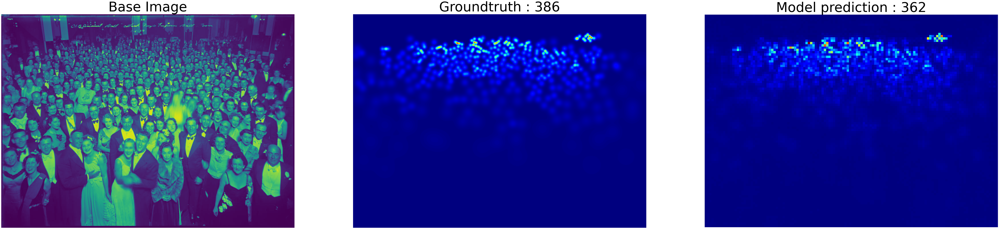

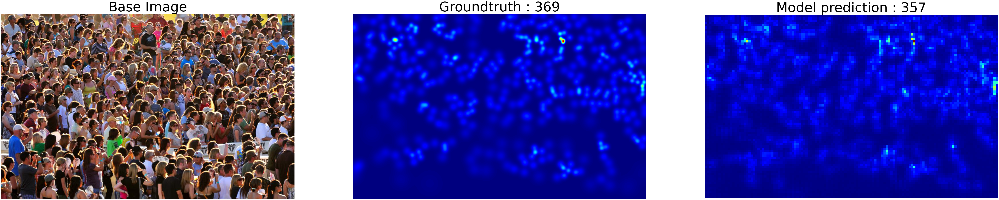

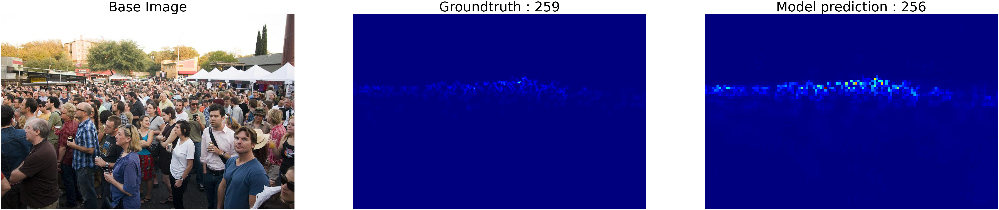

In [ ]:
#see prediction of the models 
indexes = [0,1,2]
plt.figure(figsize = (100,100))
for i in range(len(indexes)):
    gt_file = h5py.File(img_paths[indexes[i]].replace('.png','.h5').replace('images','ground_truth').replace('.jpg','.h5'),'r') #get the h5 file corresponding to the image
    visualize(img_paths[i],gt_file,model1)



<Figure size 7200x7200 with 0 Axes>

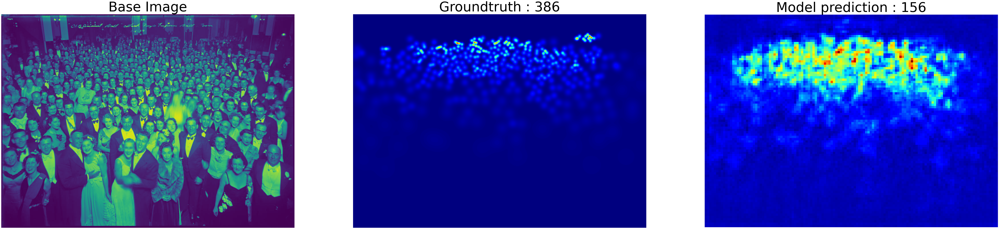

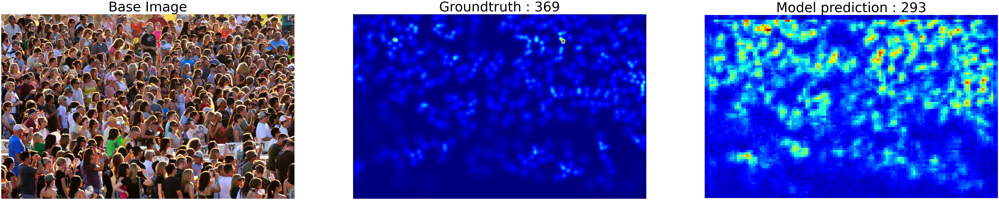

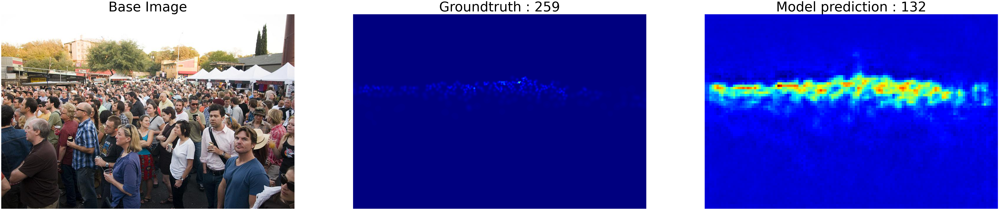

In [ ]:
indexes = [0,1,2]
plt.figure(figsize = (100,100))
for i in range(len(indexes)):
    gt_file = h5py.File(img_paths[indexes[i]].replace('.png','.h5').replace('images','ground_truth').replace('.jpg','.h5'),'r')#get the h5 file corresponding to the image
    visualize(img_paths[i],gt_file,model2)

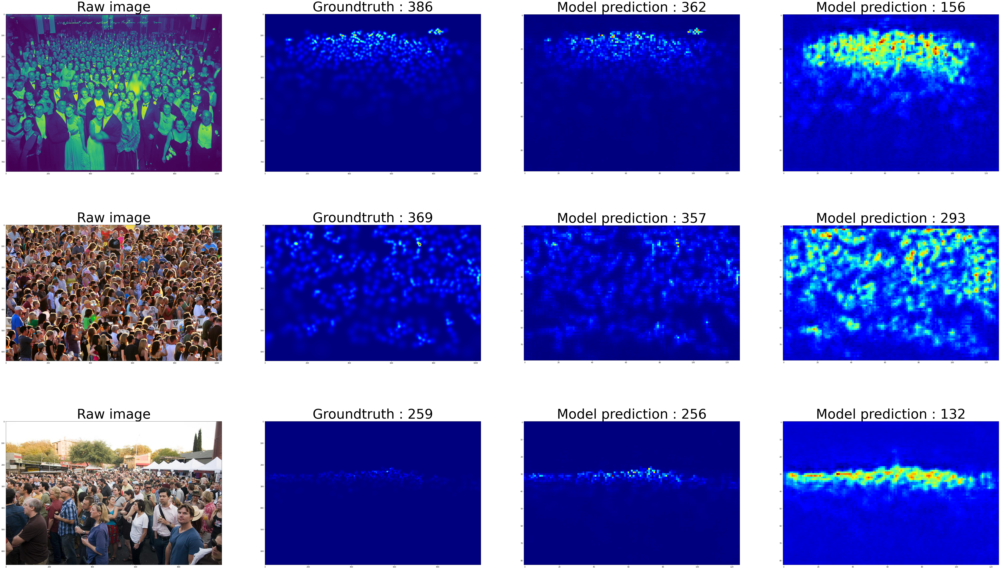

In [ ]:
#see everythong at the same time
indexes = [0,1,2]
plt.figure(figsize = (100,100))
for i in range(len(indexes)):
    gt_file = h5py.File(img_paths[indexes[i]].replace('.png','.h5').replace('.jpg','.h5').replace('images','ground_truth'),'r')
    groundtruth = np.asarray(gt_file['density'])
    nbr1, output = predict(model1,img_paths[indexes[i]])
    nbr2, output2= predict(model2,img_paths[indexes[i]])
    
    plt.subplot(5,4,i*4+1)
    plt.imshow(Image.open(img_paths[indexes[i]]))
    plt.title("Raw image", fontsize=75)

    plt.subplot(5,4,i*4+2)
    plt.imshow(groundtruth,cmap=CM.jet)
    plt.title("Groundtruth : " + str(int(np.sum(groundtruth))), fontsize=75)

    plt.subplot(5,4,i*4+3)
    plt.imshow(np.squeeze(output.detach().cpu().numpy(),(0,1)),cmap=CM.jet)
    plt.title("Model prediction : " + str(nbr1), fontsize=75)

    
    plt.subplot(5,4,i*4+4)
    plt.imshow(np.squeeze(output2.detach().cpu().numpy(),(0,1)),cmap=CM.jet)
    plt.title("Model prediction : " + str(nbr2), fontsize=75)

plt.show()